In [1]:
from matplotlib import pyplot as plt 
import numpy as np 
from astropy.io import fits
#fits_image_filename = fits.util.get_testdata_filepath('result.fits.gz')
import matplotlib.cm as cm
import pandas as pd


In [54]:
hdu = fits.open('result_v7.fits.gz')
data = hdu[1].data
ra = np.asarray(data['ra'])
dec = np.asarray(data['dec'])
mag = data['phot_g_mean_mag']
par = data['parallax']
param_solved = data['astrometric_params_solved']
#ra_n = ra[(ra>4)]
#dec_n = dec[ra>4]
ra2 = []
dec2 = []
ra5 = []
dec5 = [] 
for i in range(len(par)):
    if(param_solved[i]==3):
        ra2.append(ra[i])
        dec2.append(dec[i])
    else :
        ra5.append(ra[i])
        dec5.append(dec[i])
print(len(ra2))
print(len(ra5))
#dec = dec[(ra>4) or (ra<8)]

#ra = [r-360 if r>180 else r for r in ra]

28857
129886


In [55]:
from astropy.io.votable import parse_single_table
table = parse_single_table("coneSearch.xml")

In [56]:
xdata = table.array

In [57]:
x_ra = [x[1] for x in xdata]
x_dec = [x[2] for x in xdata]
#print(x_ra)

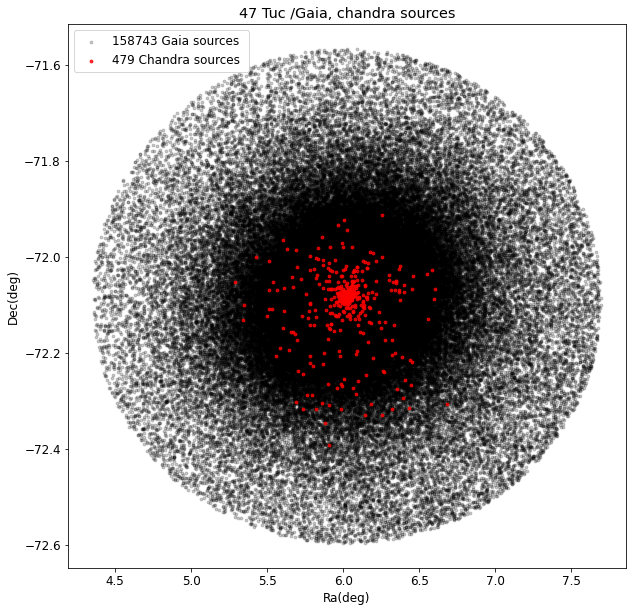

In [58]:
plt.rcParams.update({'font.size': 12})
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
#ax.set_aspect(3.0)
lab_opt = '{} Gaia sources '.format(len(ra))
lab_x = '{} Chandra sources '.format(len(x_ra))
ax.scatter(ra,dec  , s=8 , color='k' , label=lab_opt , alpha=0.2)
ax.scatter(x_ra,x_dec  , s=8 , color='red' , label=lab_x , alpha=0.8)
ax.set_xlabel('Ra(deg)')
ax.set_ylabel('Dec(deg)')
plt.title('47 Tuc /Gaia, chandra sources')
plt.legend()
plt.savefig('gaia_chandra_sources.jpg')
plt.show()

In [59]:
import pandas as pd 
xm_data = pd.read_csv('cross_match.csv')
xm_ra = xm_data['ra']
xm_dec = xm_data['dec']
xm_par = xm_data['parallax']

In [60]:
xm5_ra = []
xm5_dec = []
xm2_ra = []
xm2_dec = [] 

for i in range(len(xm_ra)):
    if(np.isnan(xm_par[i])):
        xm2_ra.append(xm_ra[i])
        xm2_dec.append(xm_dec[i])
    else :
        xm5_ra.append(xm_ra[i])
        xm5_dec.append(xm_dec[i])
print(len(xm2_ra))
print(len(xm5_ra))

32
62


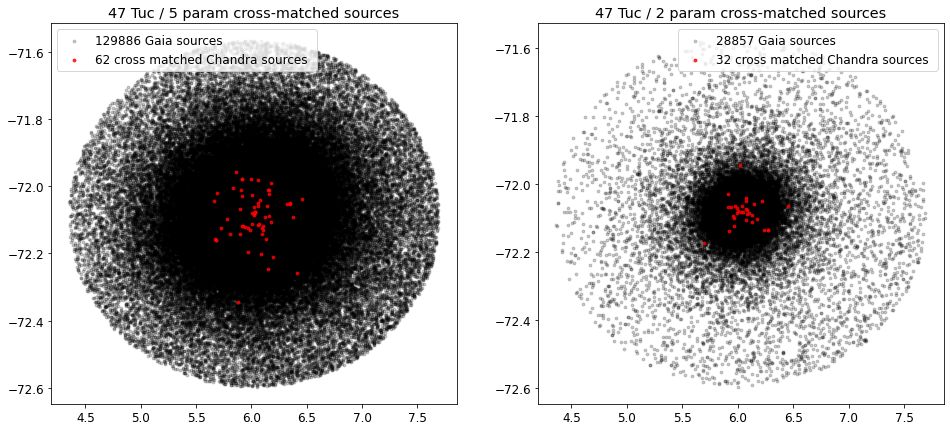

In [62]:
plt.rcParams.update({'font.size': 12})
fig = plt.figure(figsize=(16,7))
ax = fig.add_subplot(121)
#ax.set_aspect(3.0)
lab_opt = '{} Gaia sources '.format(len(ra5))
lab_x = '{} cross matched Chandra sources '.format(len(xm5_ra))
ax.scatter(ra5,dec5  , s=8 , color='k' , label=lab_opt , alpha=0.2)
ax.scatter(xm5_ra,xm5_dec , s=8 , color='red' , label=lab_x , alpha=0.8)
ax.set_title('47 Tuc / 5 param cross-matched sources')
plt.legend()


ax = fig.add_subplot(122)
#ax.set_aspect(3.0)
lab_opt = '{} Gaia sources '.format(len(ra2))
lab_x = '{} cross matched Chandra sources '.format(len(xm2_ra))
ax.scatter(ra2,dec2 , s=8 , color='k' , label=lab_opt , alpha=0.2)
ax.scatter(xm2_ra,xm2_dec , s=8 , color='red' , label=lab_x , alpha=0.8)
ax.set_title('47 Tuc / 2 param cross-matched sources')
plt.legend()


plt.savefig('gaia_chandra_xm.jpg')
plt.show()

In [6]:
import pandas as pd

In [49]:
dist_data = pd.read_csv('dist_info.csv')
r_est = dist_data['r_est'].to_numpy()/1000
r_low = dist_data['r_lo'].to_numpy()/1000
r_hi = dist_data['r_hi'].to_numpy()/1000
dec = dist_data['dec'].to_numpy()

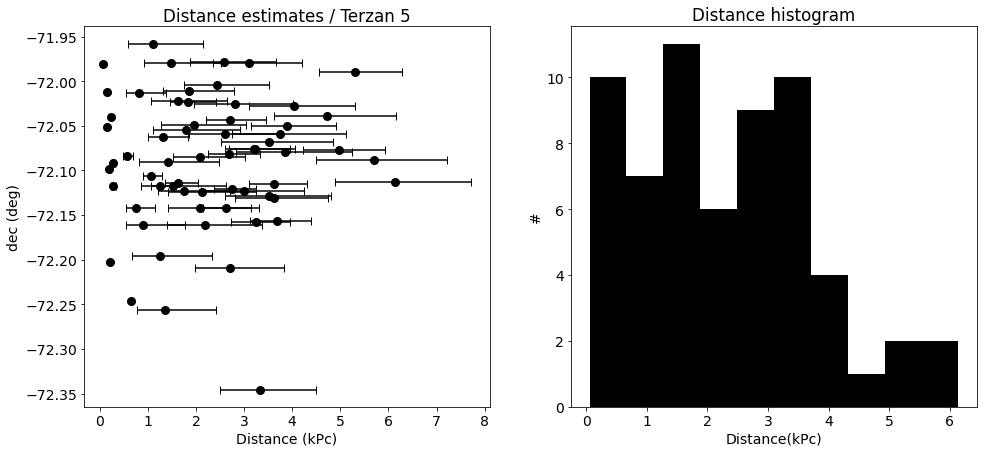

In [52]:
plt.rcParams.update({'font.size': 14})
fig = plt.figure(figsize=(16,7))
ax = fig.add_subplot(121)
#ax.set_aspect(3.0)
##lab_opt = '{} Gaia sources '.format(len(ra))
#lab_x = '{} cross matched Chandra sources '.format(len(xm_ra))
ax.errorbar(r_est , dec , xerr=(r_est-r_low , r_hi-r_est) , marker='o', markersize=8,linestyle='none' , capsize=4 , color='k')
#plt.legend()
plt.title('Distance estimates / Terzan 5')
#plt.savefig('gaia_chandra_xm.png')
ax.set_xlabel('Distance (kPc)')
ax.set_ylabel('dec (deg)')
ax2 = fig.add_subplot(122)
ax2.hist(r_est , color='k')
ax2.set_xlabel('Distance(kPc)')
ax2.set_ylabel('#')
ax2.set_title('Distance histogram')
plt.savefig('47_tuc_dist.jpg')
plt.show()